<a href="https://colab.research.google.com/github/Motz224/Pokemon_DCGANModel/blob/main/Pokemon_GANModel_20230807.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import tensorflow as tf
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL

from tensorflow.keras import layers
import time
from IPython import display

In [ ]:
#Constant
BATCH_SIZE = 32
IMAGE_SIZE = 64
noise_dim = 100
num_examples_to_generate = 16
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [ ]:
#load image
import pathlib

_URL = "https://pds-workshop-data.s3.ap-southeast-1.amazonaws.com/pokemon_jpg.zip"
path_to_zip = tf.keras.utils.get_file(
    fname="pokemon_jpg.zip",
    origin=_URL,
    extract=True)
#path_to_zip  = pathlib.Path(path_to_zip)

#PATH = path_to_zip.parent / "pokemon_jpg"

base_dir = os.path.join(os.path.dirname(path_to_zip), 'pokemon_jpg')

33236017/33236017 [==============================] - 3s 0us/step


In [ ]:
#split the image in train-0.8 validation-0.2
import shutil

classes = ["train, validation"]
for cl in classes:
  img_path = os.path.join(base_dir)
  images = glob.glob(img_path + '/*.jpg')
  print("{}: {} Images".format(cl, len(images)))

  num_train = int(round(len(images)*0.8))
  train, val = images[:num_train], images[num_train:]

for t in train:
  if not os.path.exists(os.path.join(base_dir, 'train/1')):
    os.makedirs(os.path.join(base_dir, 'train/1'))
  shutil.move(t, os.path.join(base_dir, 'train/1'))

for v in val:
  if not os.path.exists(os.path.join(base_dir, 'val/1')):
    os.makedirs(os.path.join(base_dir, 'val/1'))
  shutil.move(v, os.path.join(base_dir, 'val/1'))

train, validation: 819 Images
train, validation: 819 Images


Error: ignored

In [ ]:
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'val')

In [ ]:
train_dataset = tf.keras.utils.image_dataset_from_directory(
  train_dir,
  labels=None,
  image_size=(IMAGE_SIZE, IMAGE_SIZE),
  batch_size=BATCH_SIZE,
  #seed=1,
  #validation_split=0.2,
  #subset="training"
  )
validation_dataset = tf.keras.utils.image_dataset_from_directory(
  val_dir,
  labels=None,
  image_size=(IMAGE_SIZE, IMAGE_SIZE),
  batch_size=BATCH_SIZE,
  #seed=1,
  #validation_split=0.2,
  #subset="validation"
  )
train_dataset

Found 655 files belonging to 1 classes.
Found 164 files belonging to 1 classes.


<_BatchDataset element_spec=TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32, name=None)>

In [ ]:
"""resize_and_rescale = tf.keras.Sequential([
  layers.Resizing(IMAGE_SIZE, IMAGE_SIZE),
  layers.Rescaling(1./255)
])"""

data_augmentation = tf.keras.Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
])

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

def prepare(ds, shuffle=False, augment=False):
  """# Resize and rescale all datasets.
  ds = ds.map(lambda x: (resize_and_rescale(x)),
              num_parallel_calls=AUTOTUNE)"""

  if shuffle:
    ds = ds.shuffle(1000)

  # Batch all datasets.
  #ds = ds.batch(BATCH_SIZE)

  # Use data augmentation only on the training set.
  if augment:
    ds = ds.map(lambda x: (data_augmentation(x, training=True)),
                num_parallel_calls=AUTOTUNE)

  # Use buffered prefetching on all datasets.
  return ds.prefetch(buffer_size=AUTOTUNE)

In [ ]:
# [updated by Jason] missing pre-processing
def preprocess(image_batch):
  image_batch = tf.cast(image_batch, tf.float32)
  image_batch = image_batch / 127.5 - 1
  return image_batch

train_dataset

<_BatchDataset element_spec=TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32, name=None)>

In [ ]:
def train_ds_aug(ds):
  ds = prepare(ds, shuffle=True, augment=True)
  ds = ds.map(preprocess).prefetch(tf.data.AUTOTUNE)
  return ds

In [ ]:
train_dataset = train_ds_aug(train_dataset)

In [ ]:
validation_dataset = prepare(validation_dataset)
validation_dataset = validation_dataset.map(preprocess).prefetch(tf.data.AUTOTUNE)

In [ ]:
!ls /root/.keras/datasets/pokemon_jpg

100.jpg		  267.jpg	    425.jpg		  592f.jpg
101.jpg		  268.jpg	    426.jpg		  592.jpg
102.jpg		  269.jpg	    427.jpg		  593f.jpg
103.jpg		  26.jpg	    428.jpg		  593.jpg
104.jpg		  270.jpg	    428-mega.jpg	  594.jpg
105.jpg		  271.jpg	    429.jpg		  595.jpg
106.jpg		  272.jpg	    42.jpg		  596.jpg
107.jpg		  273.jpg	    430.jpg		  597.jpg
108.jpg		  274.jpg	    431.jpg		  598.jpg
109.jpg		  275.jpg	    432.jpg		  599.jpg
10.jpg		  276.jpg	    433.jpg		  59.jpg
110.jpg		  277.jpg	    434.jpg		  5.jpg
111.jpg		  278.jpg	    435.jpg		  600.jpg
112.jpg		  279.jpg	    436.jpg		  601.jpg
113.jpg		  27.jpg	    437.jpg		  602.jpg
114.jpg		  280.jpg	    438.jpg		  603.jpg
115.jpg		  281.jpg	    439.jpg		  604.jpg
115-mega.jpg	  282.jpg	    43.jpg		  605.jpg
116.jpg		  282-mega.jpg	    440.jpg		  606.jpg
117.jpg		  283.jpg	    441.jpg		  607.jpg
118.jpg		  284.jpg	    442.jpg		  608.jpg
119.jpg		  285.jpg	    443.jpg		  609.jpg
11.jpg		  286.jpg	    444.jpg		  60.jpg
120.jpg		  287.jpg	    445.jp

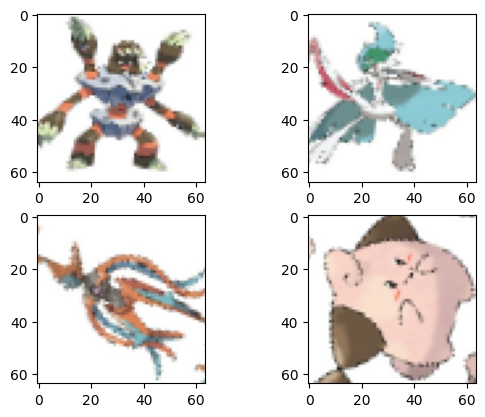

In [ ]:
# Visualize images from dataset
for batch in train_dataset:
    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.imshow(((batch.numpy() + 1) / 2)[i])  # get in the range [0, 1] for visualizing
    break
plt.show()

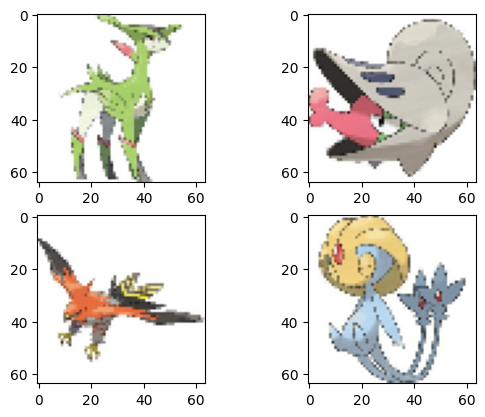

In [ ]:
# Visualize images from dataset
for batch in validation_dataset:
    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.imshow(((batch.numpy() + 1) / 2)[i])  # get in the range [0, 1] for visualizing
    break
plt.show()

In [ ]:
def make_generator_model():
  initializer = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.1)
  model = tf.keras.Sequential()
  model.add(layers.Input(shape=[noise_dim,]))

  model.add(layers.Dense(4*4*1024, use_bias=False, kernel_initializer=initializer))
  model.add(layers.Reshape((4, 4, 1024)))
  assert model.output_shape == (None, 4, 4, 1024)

  model.add(layers.Conv2DTranspose(512, kernel_size=(5, 5), strides=(2, 2), padding='same'))
  assert model.output_shape == (None, 8, 8, 512)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(256, kernel_size=(5, 5), strides=(2, 2), padding='same'))
  assert model.output_shape == (None, 16, 16, 256)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2), padding='same'))
  assert model.output_shape == (None, 32, 32, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same'))
  assert model.output_shape == (None, 64, 64, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2D(3, kernel_size=(5, 5), strides=(1, 1), padding='same', activation='tanh'))
  assert model.output_shape == (None, 64, 64, 3)

  return model

In [ ]:
def make_discriminator_model():
  initializer = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.1)
  model = tf.keras.Sequential()
  model.add(layers.Input(shape=[64,64,3]))

  model.add(layers.Conv2D(32, kernel_size=(5, 5), strides=(2, 2), padding="same",kernel_initializer=initializer))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  #model.add(layers.Dropout(0.2))

  model.add(layers.Conv2D(64, kernel_size=(5, 5), strides=(2, 2), padding="same"))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  #model.add(layers.Dropout(0.2))

  model.add(layers.Conv2D(128, kernel_size=(5, 5), strides=(2, 2), padding="same"))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  #model.add(layers.Dropout(0.2))

  model.add(layers.Conv2D(256, kernel_size=(5, 5), strides=(2, 2), padding="same"))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  #model.add(layers.Dropout(0.2))

  model.add(layers.Conv2D(512, kernel_size=(5, 5), strides=(2, 2), padding="same"))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  model.add(layers.Dropout(0.2))

  model.add(layers.Flatten())
  #model.add(layers.Dense(4*4*1024, use_bias=False))
  model.add(layers.Dense(1, activation="sigmoid"))

  return model

In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
def discriminator_loss(real_output, fake_output, weak_flag):
  #chage label
  if weak_flag == False:
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
  else:
    real_loss = cross_entropy(tf.zeros_like(real_output), real_output)
    fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
  return total_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [ ]:
generator = make_generator_model()
discriminator = make_discriminator_model()

In [ ]:
generator.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 16384)             1638400   
                                                                 
 reshape (Reshape)           (None, 4, 4, 1024)        0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 512)        13107712  
 nspose)                                                         
                                                                 
 batch_normalization (BatchN  (None, 8, 8, 512)        2048      
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 16, 16, 256)     

In [ ]:
discriminator.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 32)        2432      
                                                                 
 batch_normalization_4 (Batc  (None, 32, 32, 32)       128       
 hNormalization)                                                 
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 64)        51264     
                                                                 
 batch_normalization_5 (Batc  (None, 16, 16, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 64)       

In [ ]:
def save_loss(epoch,train_flag):
  noise = tf.random.normal([1, 100])
  generated_image = generator(noise, training=False)
  for batch in validation_dataset:
    for i in range(1):
      real_op = discriminator(batch)
    break
  fake_op = discriminator(generated_image)
  #print("Discriminator_Dicision:", fake_op)
  #print("Discriminator_Loss:", discriminator_loss(real_op,fake_op))
  #print("Generator_Loss:", generator_loss(fake_op))

  D_Loss = discriminator_loss(real_op,fake_op,False)
  G_Loss = generator_loss(fake_op)

  #change it to element
  fake_op = fake_op.numpy().item(0,0)
  data = {
      "Epoch": epoch,
      "Discriminator_Dicision": fake_op,
      "Discriminator_Loss": D_Loss.numpy().astype(float),
      "Generator_Loss": G_Loss.numpy().astype(float)
  }

  writeCSV(data,epoch,train_flag)

In [ ]:
def writeCSV(dict_data,epoch,train_flag):
  #switch open file
  import csv
  csv_columns = ["Epoch", "Discriminator_Dicision", "Discriminator_Loss", "Generator_Loss"]
  if train_flag == True:
    csv_file = "training_loss_record.csv"
  else:
    csv_file = "validation_loss_record.csv"

  #continue the epoch num if before have trained
  if epoch == 1:
    epoch_add_flag = False
    ds = pd.read_csv(csv_file)
    epoch_num = ds["Epoch"].iloc[-1]
    if epoch_num !=0:
      epoch_add_flag = True

  if epoch_add_flag == True
    dict_data.update({"Epoch":epoch_num+epoch})

  #write
  try:
    with open(csv_file, 'a+') as csvfile:
      writer = csv.DictWriter(csvfile, fieldnames=csv_columns)
      if epoch == 1 and FileHead == True:
        writer.writeheader()
      #for data in dict_data:
      writer.writerow(dict_data)
  except IOError:
    print("I/O error")

SyntaxError: ignored

In [ ]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5)
      #plt.imshow(predictions[0, :, :,:])
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images, weak_flag, train_flag):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=train_flag)

    # images, label = images_data
    real_output = discriminator(images, training=train_flag)
    fake_output = discriminator(generated_images, training=train_flag)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output, weak_flag)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  if train_flag==True:
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
def train(dataset, epochs, train_flag):
  for epoch in range(epochs):
    start = time.time()

    #each time do data augmentation and random generate different image
    #dataset = train_ds_aug(dataset)

    #for evey 50 chage the label of real and fake in discriminator to weaken it
    #if (epoch+1)%50 == 0 and epoch<=150 :
    #  weak_flag = True
    #else:
    weak_flag = False

    #train
    for image_batch in dataset:
      train_step(image_batch, weak_flag, train_flag)

    # Produce images for the GIF as you go
    display.clear_output(wait=True)
    generate_and_save_images(generator,epoch + 1,seed)

    # Save the model and losses every 15 epochs
    if (epoch + 1) % 15 == 0 and train_flag==True:
      checkpoint.save(file_prefix = checkpoint_prefix)

    if(epoch+1)%1 == 0 or epoch == 0 :
      save_loss(epoch+1,train_flag)

    # Save Disc
    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator,epochs,seed)

In [ ]:
# checkpoint_dir = './drive/MyDrive/projects/training_checkpoints'
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                  discriminator_optimizer=discriminator_optimizer,
                  generator=generator,
                  discriminator=discriminator)

In [ ]:
#Since the file download from drive will be lossy compressed, the checkpoint cant restore
#checkpoint_dir = "./drive/MyDrive/DCGAN_20230408"

In [ ]:
#restore checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
tf.train.latest_checkpoint(checkpoint_dir)

In [ ]:
#Save initial checkpt and loss
checkpoint.save(file_prefix = checkpoint_prefix)
checkpoint_dir = './training_checkpoints'

In [ ]:
EPOCHS = 300

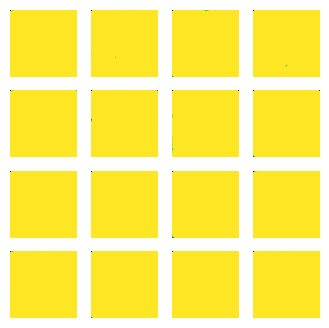

In [ ]:
global FileHead = False
train(train_dataset, 1, True)

<ipython-input-54-1eb83e015288>:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-54-1eb83e015288>:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 9.5 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.12.0 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 3.19.6 which is incompatible.
tensorflow-datasets 4.9.2 requires protobuf>=3.20, but you have protobuf 3.19.6 which is incompatible.
tensorflow-metadata 1.13.1 requires protobuf<5,>=3.20.3, but you have protobuf 3.19.6 which is incompatible.



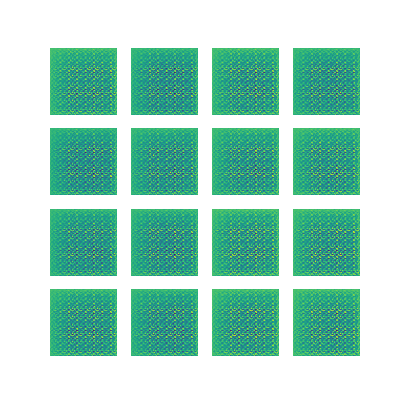

In [ ]:
#processing gif
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

!pip install -q git+https://github.com/MJAHMADEE/docs
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

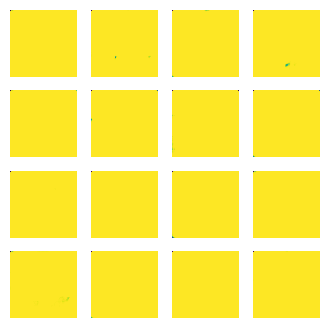

KeyboardInterrupt: ignored

In [ ]:
#check model with validation record and record to loss
train(validation_dataset, EPOCHS, False)

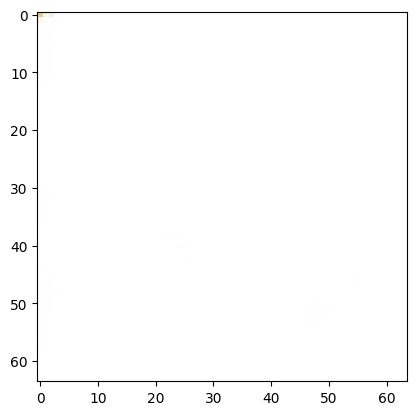

In [ ]:
#Generate Test
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
plt.imshow(generated_image[0, :, :,:])

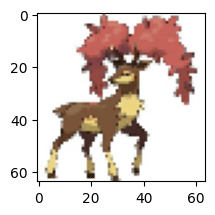

In [ ]:
for batch in validation_dataset:
    for i in range(1):
        plt.subplot(2, 2, i+1)
        plt.imshow(((batch.numpy() + 1) / 2)[i])  # get in the range [0, 1] for visualizing

        real_op = discriminator(batch)
    break
plt.show()

In [ ]:
fake_op = discriminator(generated_image)
print("Discriminator_Dicision:", fake_op)
print("Discriminator_Loss:", discriminator_loss(real_op,fake_op,False))
print("Generator_Loss:", generator_loss(fake_op))

Discriminator_Dicision: tf.Tensor([[8.1472185e-20]], shape=(1, 1), dtype=float32)
Discriminator_Loss: tf.Tensor(1.051264e-08, shape=(), dtype=float32)
Generator_Loss: tf.Tensor(43.954025, shape=(), dtype=float32)


In [ ]:
#show loss record
import pandas as pd
training_loss_record = pd.read_csv("training_loss_record.csv")
validation_loss_record = pd.read_csv("validation_loss_record.csv")
training_loss_record.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300 entries, 0 to 299
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Epoch                   300 non-null    int64  
 1   Discriminator_Dicision  300 non-null    float64
 2   Discriminator_Loss      300 non-null    float64
 3   Generator_Loss          300 non-null    float64
dtypes: float64(3), int64(1)
memory usage: 9.5 KB


Text(0.5, 0.98, 'Training Loss Record')

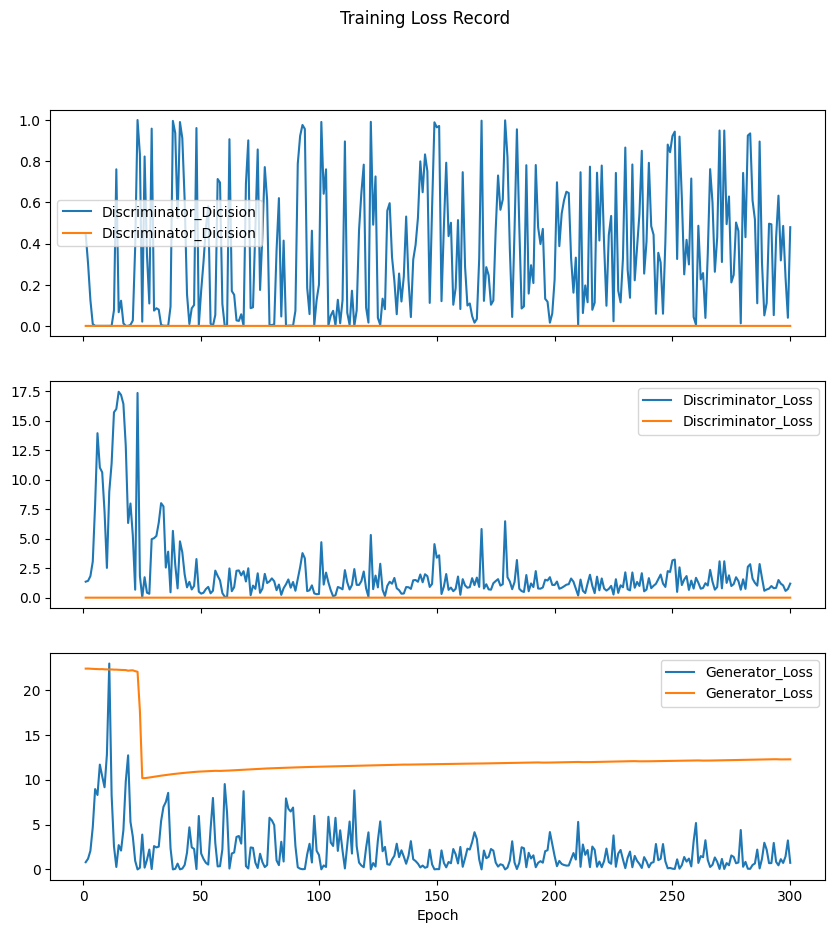

In [ ]:
fig, axes = plt.subplots(3,1,sharex=True,figsize=(10, 10))
training_loss_record.plot(x="Epoch", y="Discriminator_Dicision", ax=axes[0])
training_loss_record.plot(x="Epoch", y="Discriminator_Loss", ax=axes[1])
training_loss_record.plot(x="Epoch", y="Generator_Loss", ax=axes[2])

validation_loss_record.plot(x="Epoch", y="Discriminator_Dicision", ax=axes[0])
validation_loss_record.plot(x="Epoch", y="Discriminator_Loss", ax=axes[1])
validation_loss_record.plot(x="Epoch", y="Generator_Loss", ax=axes[2])
plt.suptitle("Training Loss Record")